In [2]:
# HPC
import numpy as np
import xarray as xr
from scipy.interpolate import interp1d

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Paths and stuff
import os
import sys

import re
import warnings
warnings.filterwarnings("ignore")

sys.path.append('/home/shreyas/pySICOPOLIS/src')
from pySICOPOLIS import *

def extract_costs_from_file(filepath, iter_final):
    cost_list = []
    misfit_cost_list = []
    reg_cost_list = []

    pattern = re.compile(
        r"Iteration\s+\d+:\s+Cost\s+=\s+([0-9.]+),\s+Misfit Cost\s+=\s+([0-9.]+),\s+Regularization Cost\s+=\s+([0-9.]+)"
    )

    with open(filepath, 'r') as file:
        for line in file:
            match = pattern.search(line)
            if match:
                cost, misfit, reg = map(float, match.groups())
                cost_list.append(cost)
                misfit_cost_list.append(misfit)
                reg_cost_list.append(reg)

    return cost_list[:iter_final + 1], misfit_cost_list[:iter_final + 1], reg_cost_list[:iter_final + 1]

In [9]:
ds = xr.load_dataset("/scratch2/shreyas/optim_SVC_3point5_50_new_pickup_2/inexact_gn_hessian_cg/state_GNHessCG_iter_25.nc")
10.0**ds["xx_p_weert"].data[0],\
10.0**ds["xx_q_weert"].data[0],\
10.0**ds["xx_enh_fact_da_dummy2d_scalar"].data[0],\
10.0**ds["xx_enh_intg_da_dummy2d_scalar"].data[0],\
10.0**ds["xx_n_glen_da_dummy2d_scalar"].data[0]

(3.0743770006503643,
 1.914907457197789,
 2.5139512269066464,
 0.9911238858902123,
 3.559348181628098)

In [8]:
ds

<xarray.Dataset> Size: 51kB
Dimensions:                        (y: 73, x: 43, scalar: 1)
Coordinates:
  * y                              (y) float64 584B -3.45e+03 ... -570.0
  * x                              (x) float64 344B -720.0 -680.0 ... 960.0
Dimensions without coordinates: scalar
Data variables:
    xx_c_slide_init                (y, x) float64 25kB -0.07088 ... -0.07065
    xx_q_geo                       (y, x) float64 25kB -1.286 -1.28 ... -1.146
    xx_p_weert                     (scalar) float64 8B 0.4878
    xx_q_weert                     (scalar) float64 8B 0.2821
    xx_enh_fact_da_dummy2d_scalar  (scalar) float64 8B 0.4004
    xx_enh_intg_da_dummy2d_scalar  (scalar) float64 8B -0.003872
    xx_n_glen_da_dummy2d_scalar    (scalar) float64 8B 0.5514

In [2]:
# suffix = "_modified_constrained"

# ds_1 = xr.open_dataset(f"/scratch2/shreyas/optim_ABZ{suffix}/inexact_gn_hessian_cg/state_GNHessCG_iter_11.nc")
# ds_0 = xr.open_dataset(f"/scratch2/shreyas/optim_ABZ{suffix}/inexact_gn_hessian_cg/state_GNHessCG_iter_0.nc")
# ds_init = xr.open_dataset("/home/shreyas/update_to_develop_sicopolis/sicopolis_spinups/sico_out/grl40_bm5_paleo17a_CT4_BH0_8point5CS_spinup_0ka/grl40_bm5_paleo17a_CT4_BH0_8point5CS_spinup_0ka0006.nc")

# dataPath = '/scratch2/shreyas/GrIS_paleo_data/'
# ds_bm5_40kms = xr.open_dataset(dataPath + 'bm5_data_40kms.nc')
# ds_age_40kms = xr.open_dataset(dataPath + 'age_data_40kms.nc')
# ds_model = xr.open_dataset(f"/scratch2/shreyas/optim_ABZ{suffix}/inexact_gn_hessian_cg/final_sim_output_GNHessCG_iter_0_fields.nc")
# ds_model_final = xr.open_dataset(f"/scratch2/shreyas/optim_ABZ{suffix}/inexact_gn_hessian_cg/final_sim_output_GNHessCG_iter_11_fields.nc")

# n_rows, n_cols = 10, 2
# aspect_ratio = len(xModel40)/len(yModel40)
# subplot_width = 4
# subplot_height = subplot_width / aspect_ratio
# plt.rcParams["figure.figsize"] = ((n_cols+1.5)*subplot_width, n_rows*subplot_height)
# fig, ax = plt.subplots(n_rows, n_cols)

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_1["xx_zs"].data - ds_1["xx_zl"].data,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -500, vmax = 500, fig = fig, ax = ax[0, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_1["xx_delta_tda_const"].data,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -0.02, vmax = 0.02, fig = fig, ax = ax[0, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_1["xx_delta_tda_const"].data,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -0.02, vmax = 0.02, fig = fig, ax = ax[1, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_1["xx_delta_tda"].data[-1],
#                          cmap = 'RdBu_r', nbins = 100, vmin = -0.002, vmax = 0.002, fig = fig, ax = ax[1, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          10**ds_1["xx_age_c"].data[40] - 10**ds_0["xx_age_c"].data[40],
#                          cmap = 'RdBu_r', nbins = 100, vmin = -5000, vmax = 5000, fig = fig, ax = ax[2, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          10**ds_1["xx_age_c"].data[0] - 10**ds_0["xx_age_c"].data[0],
#                          cmap = 'RdBu_r', nbins = 100, vmin = -50000, vmax = 50000, fig = fig, ax = ax[2, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_model["H"].data - ds_bm5_40kms["H"].data,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1500, vmax = 1500, fig = fig, ax = ax[3, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_model_final["H"].data - ds_bm5_40kms["H"].data,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1500, vmax = 1500, fig = fig, ax = ax[3, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          (ds_model["H"].data - ds_bm5_40kms["H"].data)*(ds_bm5_40kms["H"].data >= 2000.0),
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1500, vmax = 1500, fig = fig, ax = ax[4, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          (ds_model_final["H"].data - ds_bm5_40kms["H"].data)*(ds_bm5_40kms["H"].data >= 2000.0),
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1500, vmax = 1500, fig = fig, ax = ax[4, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_model["H"].data/ds_bm5_40kms["H"].data - 1,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1, vmax = 1, fig = fig, ax = ax[5, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          ds_model_final["H"].data/ds_bm5_40kms["H"].data - 1,
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1, vmax = 1, fig = fig, ax = ax[5, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          (ds_model["H"].data/ds_bm5_40kms["H"].data - 1)*(ds_bm5_40kms["H"].data >= 2000.0),
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1, vmax = 1, fig = fig, ax = ax[6, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          (ds_model_final["H"].data/ds_bm5_40kms["H"].data - 1)*(ds_bm5_40kms["H"].data >= 2000.0),
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1, vmax = 1, fig = fig, ax = ax[6, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          np.abs(ds_model["H"].data/ds_bm5_40kms["H"].data - 1) > np.abs(ds_model_final["H"].data/ds_bm5_40kms["H"].data - 1),
#                          cmap = 'RdBu_r', nbins = 100, vmin = -1, vmax = 1, fig = fig, ax = ax[7, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          np.abs(ds_model_final["H"].data/ds_bm5_40kms["H"].data - 1) / np.abs(ds_model["H"].data/ds_bm5_40kms["H"].data - 1),
#                          cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 2, fig = fig, ax = ax[7, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          (ds_model["H"].data - ds_bm5_40kms["H"].data)**2/ds_bm5_40kms["H_uncert_modified"].data**2 * (ds_bm5_40kms["H"].data > 2000.0),
#                          cmap = 'jet', nbins = 100, vmin = 0, vmax = 500, fig = fig, ax = ax[8, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          (ds_model_final["H"].data - ds_bm5_40kms["H"].data)**2/ds_bm5_40kms["H_uncert_modified"].data**2 * (ds_bm5_40kms["H"].data > 2000.0),
#                          cmap = 'jet', nbins = 100, vmin = 0, vmax = 500, fig = fig, ax = ax[8, 1])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          np.mean((ds_model["age_c"].data - ds_age_40kms["age_c"].data)**2/ds_age_40kms["age_c_uncert"].data**2, axis = 0) * (ds_bm5_40kms["H"].data > 2000.0),
#                          cmap = 'jet', nbins = 100, vmin = 0, vmax = 10, fig = fig, ax = ax[9, 0])

# fancyPlotter.plot_normal(xModel40, 
#                          yModel40, 
#                          np.mean((ds_model_final["age_c"].data - ds_age_40kms["age_c"].data)**2/ds_age_40kms["age_c_uncert"].data**2, axis = 0) * (ds_bm5_40kms["H"].data > 2000.0),
#                          cmap = 'jet', nbins = 100, vmin = 0, vmax = 10, fig = fig, ax = ax[9, 1])

# plt.tight_layout()

# plt.rcParams["figure.figsize"] = (15,15)
# fig, ax = plt.subplots(1,3, width_ratios=[1,1,2])

# fancyPlotter.plot_normal(ds_age_40kms['x'], ds_age_40kms['y'], 
#                          ds_age_40kms['H'],
#                          cmap = 'jet', nbins = 100, vmin = 0,
#                          fig = fig, ax = ax[2],
#                          cbar_label = 'metres')
# ax[2].set_title(f'Ice thickness plot', fontsize=10)

# xIndex = 27
# yIndex = 38

# xLoc = ds_age_40kms['x'][xIndex].data
# yLoc = ds_age_40kms['y'][yIndex].data
# age_z = ds_age_40kms['age_c'][:,yIndex,xIndex]
# age_z_uncert = ds_age_40kms['age_c_uncert'][:,yIndex,xIndex]
# age_z_uncert[age_z_uncert < 0] = 0.0
# age_z_model = ds_model["age_c"][:,yIndex,xIndex]
# age_z_model_final = ds_model_final["age_c"][:,yIndex,xIndex]
# depth_z = ds_age_40kms['sigma'].data*ds_age_40kms["H"].data[yIndex, xIndex]
# depth_z_model = ds_age_40kms['sigma'].data*ds_model["H"].data[yIndex, xIndex]
# depth_z_model_final = ds_age_40kms['sigma'].data*ds_model_final["H"].data[yIndex, xIndex]

# fancyPlotter.plot_1D_depth_profile(age_z/1000, depth_z, age_z_uncert/1000,
#                                    fig=fig, ax = ax[0], 
#                                    linestyle='-', marker='o', color='b',
#                                    label = 'Age')

# fancyPlotter.plot_1D_depth_profile(age_z_model/1000, depth_z_model, None,
#                                    fig=fig, ax = ax[0], 
#                                    linestyle='-', marker='o', color='r',
#                                    label = 'Age Model')

# fancyPlotter.plot_1D_depth_profile(age_z_model_final/1000, depth_z_model_final, None,
#                                    fig=fig, ax = ax[0], 
#                                    linestyle='-', marker='o', color='g',
#                                    label = 'Age Model Final')

# ax[0].set_title(f'x = {xLoc:.2e}, y = {yLoc:.2e}', fontsize=10)
# ax[0].set_xlabel(f'Age in ka', fontsize=10)
# ax[2].scatter(xLoc, yLoc, s=250, c='black', marker='x')
# ax[0].legend()

# xIndex = int(ds_age_40kms['x'].shape[0]/2)
# yIndex = int(ds_age_40kms['y'].shape[0]/2)

# xLoc = ds_age_40kms['x'][xIndex].data
# yLoc = ds_age_40kms['y'][yIndex].data
# age_z = ds_age_40kms['age_c'][:,yIndex,xIndex]
# age_z_uncert = ds_age_40kms['age_c_uncert'][:,yIndex,xIndex]
# age_z_uncert[age_z_uncert < 0] = 0.0
# age_z_model = ds_model["age_c"][:,yIndex,xIndex]
# age_z_model_final = ds_model_final["age_c"][:,yIndex,xIndex]
# depth_z = ds_age_40kms['sigma'].data*ds_age_40kms["H"].data[yIndex, xIndex]
# depth_z_model = ds_age_40kms['sigma'].data*ds_model["H"].data[yIndex, xIndex]
# depth_z_model_final = ds_age_40kms['sigma'].data*ds_model_final["H"].data[yIndex, xIndex]

# fancyPlotter.plot_1D_depth_profile(age_z/1000, depth_z, age_z_uncert/1000*(age_z_uncert >= 0),
#                                    fig=fig, ax = ax[1], 
#                                    linestyle='-', marker='o', color='b',
#                                    label = 'Age')

# fancyPlotter.plot_1D_depth_profile(age_z_model/1000, depth_z_model, None,
#                                    fig=fig, ax = ax[1], 
#                                    linestyle='-', marker='o', color='r',
#                                    label = 'Age Model')

# fancyPlotter.plot_1D_depth_profile(age_z_model_final/1000, depth_z_model_final, None,
#                                    fig=fig, ax = ax[1], 
#                                    linestyle='-', marker='o', color='g',
#                                    label = 'Age Model Final')

# ax[1].set_title(f'x = {xLoc:.2e}, y = {yLoc:.2e}', fontsize=10)
# ax[1].set_xlabel(f'Age in ka', fontsize=10)
# ax[2].scatter(xLoc, yLoc, s=250, c='black', marker='x')
# ax[1].legend()

# plt.tight_layout()

NameError: name 'xModel40' is not defined

In [ ]:
# for var in ds_0:
#     if np.linalg.norm(ds_0[var].data) != 0.0:
#         print(f"{var}: {np.linalg.norm(ds_1[var].data - ds_0[var].data)/ np.linalg.norm(ds_0[var].data)}")
#     else:
#         print(f"{var}: {np.linalg.norm(ds_1[var].data - ds_0[var].data)}")

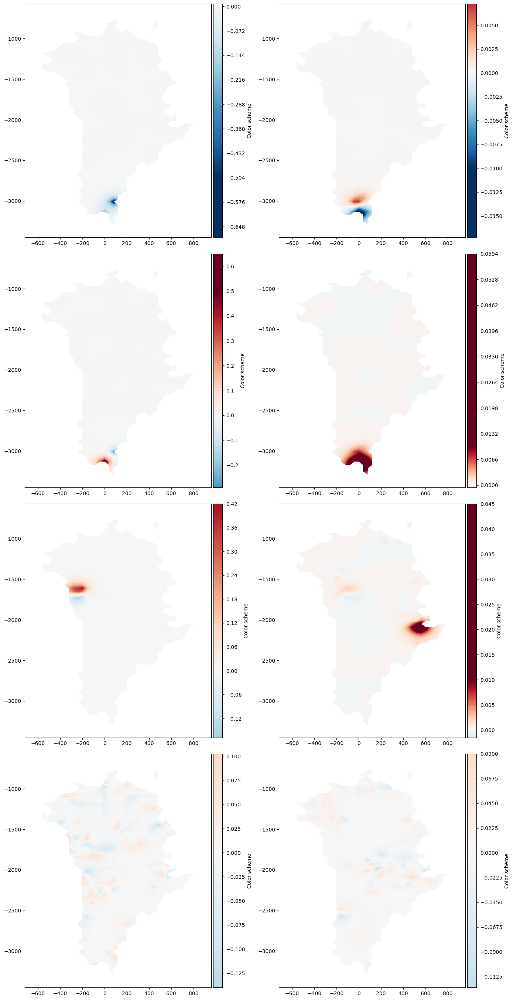

In [3]:
U_misfit_sa = np.load("/scratch2/shreyas/REVD_3point5_80_pickup/REVD_single_approx/U_misfit_87.npy")
U_misfit_sa_reshaped = np.reshape(U_misfit_sa[:73*43, :], (73, 43, -1))
U_misfit_sa_reshaped_1 = np.reshape(U_misfit_sa[73*43:2*73*43, :], (73, 43, -1))

xModel40 = np.arange(-72.,97.,4.0)*10
yModel40 = np.arange(-345.,-56.,4.0)*10

H_data_40 = xr.open_dataset("/scratch2/shreyas/GrIS_paleo_data/bm5_data_40kms.nc")
H_data = H_data_40["H"].data
mask = 1.0*(H_data > 0)
mask[mask == 0] = np.nan

n_rows, n_cols = 4, 2
aspect_ratio = len(xModel40)/len(yModel40)
subplot_width = 4
subplot_height = subplot_width / aspect_ratio
plt.rcParams["figure.figsize"] = ((n_cols+1.5)*subplot_width, n_rows*subplot_height)
fig, ax = plt.subplots(n_rows, n_cols)

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped[:, :, 0]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.5, vmax = 0.5, fig = fig, ax = ax[0, 0])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped_1[:, :, 0]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.01, vmax = 0.01, fig = fig, ax = ax[0, 1])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped[:, :, 1]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.5, vmax = 0.5, fig = fig, ax = ax[1, 0])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped_1[:, :, 1]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.01, vmax = 0.01, fig = fig, ax = ax[1, 1])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped[:, :, 2]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.5, vmax = 0.5, fig = fig, ax = ax[2, 0])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped_1[:, :, 2]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.01, vmax = 0.01, fig = fig, ax = ax[2, 1])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped[:, :, -1]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.5, vmax = 0.5, fig = fig, ax = ax[3, 0])

fancyPlotter.plot_normal(xModel40, 
                         yModel40, 
                         U_misfit_sa_reshaped_1[:, :, -1]*mask,
                         cmap = 'RdBu_r', nbins = 100, vmin = -0.5, vmax = 0.5, fig = fig, ax = ax[3, 1])

plt.tight_layout()

In [4]:
modelPath = '/home/shreyas/update_to_develop_sicopolis/sicopolis_spinups/sico_out/'
dataPath = '/scratch2/shreyas/GrIS_paleo_data/'

H_data_40 = xr.open_dataset("/scratch2/shreyas/GrIS_paleo_data/bm5_data_40kms.nc")
H_data_40_orig = xr.open_dataset("/scratch2/shreyas/GrIS_paleo_data/bm5_data_40kms_orig.nc")
ds_surfvel_data_40km = xr.open_dataset(dataPath + 'surfvel_data_40kms.nc')
ds_surfvel_model_40km_nottuned = xr.open_dataset(modelPath + 'grl40_bm5_paleo17a_nudged_CT4_BH0_m21ka_pkp/grl40_bm5_paleo17a_nudged_CT4_BH0_m21ka_pkp0007.nc')

H_data = H_data_40["H"].data
mask = 1.0*(H_data > 0)
mask[mask == 0] = np.nan

vs_orig_data = ds_surfvel_data_40km["vs_orig"].data
vs_data = ds_surfvel_data_40km["vs"].data
vx_data = ds_surfvel_data_40km["vx"].data
vy_data = ds_surfvel_data_40km["vy"].data

# Cost function is the sum of 2 ratios, each of which is 1/2*(non-zero data), so total should be 1.0*(non-zero data)
one_sigma_threshold = np.sum(vs_data != 0.0)

vs_model_nottuned = (ds_surfvel_model_40km_nottuned['vx_s_g'].data**2 + ds_surfvel_model_40km_nottuned['vy_s_g'].data**2)**0.5
vx_model_nottuned = ds_surfvel_model_40km_nottuned['vx_s_g'].data
vy_model_nottuned = ds_surfvel_model_40km_nottuned['vy_s_g'].data

mask_land = ds_surfvel_model_40km_nottuned["mask"].data.copy()
mask_land[mask_land == 0] = -1
mask_land[mask_land == 1] = -1
mask_land[mask_land == 2] = 1
mask_land[mask_land == 3] = 1

mask_ice = ds_surfvel_model_40km_nottuned["mask"].data.copy()
mask_ice[mask_ice == 0] = -1
mask_ice[mask_ice == 3] = -1
mask_ice[mask_ice == 1] = 1
mask_ice[mask_ice == 2] = 1

In [5]:
def uncert_analysis(scale):
    data_uncert_x = ds_surfvel_data_40km["vx_uncert_unbounded"].data
    data_uncert_y = ds_surfvel_data_40km["vy_uncert_unbounded"].data
    
    model_uncert_notscaled_x = np.abs(ds_surfvel_data_40km["vx"].data)
    model_uncert_notscaled_y = np.abs(ds_surfvel_data_40km["vy"].data)
    
    total_uncert_notscaled_x = (model_uncert_notscaled_x**2 + data_uncert_x**2)**0.5
    total_uncert_notscaled_y = (model_uncert_notscaled_y**2 + data_uncert_y**2)**0.5
    
    factor = 1 - np.abs(H_data_40_orig["H"].data/np.max(H_data_40_orig["H"].data))*(scale/100.0)
    model_uncert_x = factor*np.abs(ds_surfvel_data_40km["vx"].data)
    model_uncert_y = factor*np.abs(ds_surfvel_data_40km["vy"].data)
    
    total_uncert_x = ds_surfvel_data_40km[f"vx_uncert_{scale}"].data
    total_uncert_y = ds_surfvel_data_40km[f"vy_uncert_{scale}"].data
    
    n_rows, n_cols = 7, 2
    aspect_ratio = len(ds_surfvel_model_40km_nottuned['x'])/len(ds_surfvel_model_40km_nottuned['y'])
    subplot_width = 4
    subplot_height = subplot_width / aspect_ratio
    plt.rcParams["figure.figsize"] = ((n_cols+1.5)*subplot_width, n_rows*subplot_height)
    fig, ax = plt.subplots(n_rows, n_cols)
    
    for axis in ax.flatten():
        axis.set_box_aspect(1/aspect_ratio)
        
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          data_uncert_x,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[0, 0],
                          cbar_label = "data_uncert_x")
    ax[0, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[0, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[0, 0].set_title("data_uncert_x")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          data_uncert_y,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[0, 1],
                          cbar_label = "data_uncert_y")
    ax[0, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[0, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[0, 1].set_title("data_uncert_y")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          model_uncert_notscaled_x,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[1, 0],
                          cbar_label = "model_uncert_notscaled_x")
    ax[1, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 0].set_title("model_uncert_notscaled_x")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          model_uncert_notscaled_y,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[1, 1],
                          cbar_label = "model_uncert_notscaled_y")
    ax[1, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 1].set_title("model_uncert_notscaled_y")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             data_uncert_x > model_uncert_notscaled_x,
                             cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 1,
                             fig = fig, ax = ax[2, 0],
                             cbar_label = "flag")
    ax[2, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 0].set_title("data_uncert_x > model_uncert_notscaled_x")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             data_uncert_y > model_uncert_notscaled_y,
                             cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 1,
                             fig = fig, ax = ax[2, 1],
                             cbar_label = "flag")
    ax[2, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 1].set_title("data_uncert_y > model_uncert_notscaled_y")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          total_uncert_notscaled_x,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[3, 0],
                          cbar_label = "total_uncert_notscaled_x")
    ax[3, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 0].set_title("total_uncert_notscaled_x")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          total_uncert_notscaled_y,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[3, 1],
                          cbar_label = "total_uncert_notscaled_y")
    ax[3, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 1].set_title("total_uncert_notscaled_y")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          model_uncert_x,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[4, 0],
                          cbar_label = "model_uncert_x")
    ax[4, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 0].set_title("model_uncert_x")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          model_uncert_y,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[4, 1],
                          cbar_label = "model_uncert_y")
    ax[4, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 1].set_title("model_uncert_y")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             data_uncert_x > model_uncert_x,
                             cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 1,
                             fig = fig, ax = ax[5, 0],
                             cbar_label = "flag")
    ax[5, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[5, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[5, 0].set_title("data_uncert_x > model_uncert_x")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             data_uncert_y > model_uncert_y,
                             cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 1,
                             fig = fig, ax = ax[5, 1],
                             cbar_label = "flag")
    ax[5, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[5, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[5, 1].set_title("data_uncert_y > model_uncert_y")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          total_uncert_x,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[6, 0],
                          cbar_label = "total_uncert_x")
    ax[6, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[6, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[6, 0].set_title("total_uncert_x")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          total_uncert_y,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[6, 1],
                          cbar_label = "total_uncert_y")
    ax[6, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[6, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[6, 1].set_title("total_uncert_y")

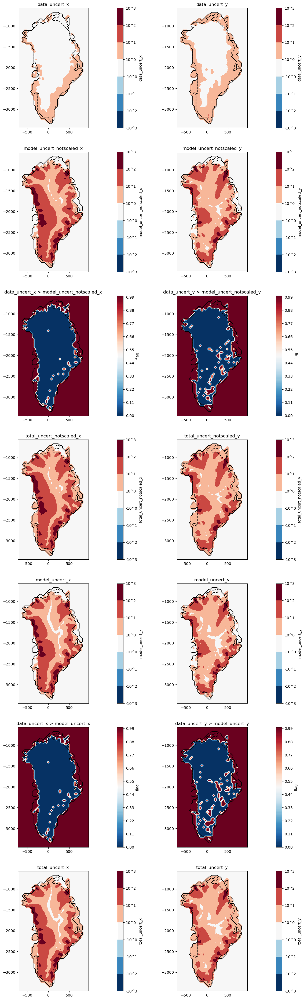

In [6]:
uncert_analysis(50)

In [7]:
def plotting(scale, suffix, iter_final, bool_pickup = False, iter_final_og_pickup = None, len_str_trunc_pickup = 7):

    ds_surfvel_model_tuned_40km = xr.open_dataset(f"/home/shreyas/update_to_develop_sicopolis/sicopolis_optim_SVC_{scale}{suffix}/sico_out/N_grl40_bm5_paleo17a_nudged_CT4_BH0_SVC_m21ka_pkp/0007.nc")

    if not bool_pickup:
        ds_init = xr.open_dataset(f"/scratch2/shreyas/optim_SVC_{scale}{suffix}/inexact_gn_hessian_cg/state_GNHessCG_iter_0.nc")
    else:
        # remove _pickup or _pickup_2 from suffix by using suffix[:-len_str_trunc_pickup]
        ds_init = xr.open_dataset(f"/scratch2/shreyas/optim_SVC_{scale}{suffix[:-len_str_trunc_pickup]}/inexact_gn_hessian_cg/state_GNHessCG_iter_0.nc")
    ds_final = xr.open_dataset(f"/scratch2/shreyas/optim_SVC_{scale}{suffix}/inexact_gn_hessian_cg/state_GNHessCG_iter_{iter_final}.nc")

    vs_model_tuned = (ds_surfvel_model_tuned_40km['vx_s_g'].data**2 + ds_surfvel_model_tuned_40km['vy_s_g'].data**2)**0.5
    vx_model_tuned = ds_surfvel_model_tuned_40km['vx_s_g'].data
    vy_model_tuned = ds_surfvel_model_tuned_40km['vy_s_g'].data

    if not bool_pickup:
        costs, misfits, regs = extract_costs_from_file(f"/scratch2/shreyas/optim_SVC_{scale}{suffix}/inexact_gn_hessian_cg/inexact_gn_hessian_cg.log", iter_final)
    else:
        # iter_final_og_pickup - 1 cuz the cost will be same for iter 0 of pickup
        costs, misfits, regs = extract_costs_from_file(f"/scratch2/shreyas/optim_SVC_{scale}{suffix[:-len_str_trunc_pickup]}/inexact_gn_hessian_cg/inexact_gn_hessian_cg.log", iter_final_og_pickup - 1)
        costs_pickup, misfits_pickup, regs_pickup = extract_costs_from_file(f"/scratch2/shreyas/optim_SVC_{scale}{suffix}/inexact_gn_hessian_cg/inexact_gn_hessian_cg.log", iter_final)
        costs = costs + costs_pickup
        misfits = misfits + misfits_pickup
        regs = regs + regs_pickup
    
    n_rows, n_cols = 7, 5
    aspect_ratio = len(ds_surfvel_model_40km_nottuned['x'])/len(ds_surfvel_model_40km_nottuned['y'])
    subplot_width = 4
    subplot_height = subplot_width / aspect_ratio
    plt.rcParams["figure.figsize"] = ((n_cols+1.5)*subplot_width, n_rows*subplot_height)
    fig, ax = plt.subplots(n_rows, n_cols)
    
    for axis in ax.flatten()[2:]:
        axis.set_box_aspect(1/aspect_ratio)
    
    ax[0, 0].plot(np.arange(len(costs)), costs / one_sigma_threshold, marker="o")
    ax[0, 0].axhline(1.0, color = "red")
    ax[0, 0].set_title("Normalized cost vs iterations")
    
    ax[0, 1].plot(regs / one_sigma_threshold, misfits / one_sigma_threshold, marker="o")
    ax[0, 1].set_title("Normalized misfit cost vs Normalized regularization cost")
        
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vs_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[0, 2],
                          cbar_label = "vs data")
    ax[0, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[0, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[0, 2].set_title("vs MEaSUREs data")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vx_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[0, 3],
                          cbar_label = "vx data")
    ax[0, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[0, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[0, 3].set_title("vx MEaSUREs data")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vy_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[0, 4],
                          cbar_label = "vy data")
    ax[0, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[0, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[0, 4].set_title("vy MEaSUREs data")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_init["xx_c_slide_init"].data,
                            cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 1.7,
                            fig = fig, ax = ax[1, 0],
                            cbar_label = "Basal sliding coefficient")
    ax[1, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 0].set_title("Basal sliding coefficient not tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_init["xx_q_geo"].data,
                            cmap = 'jet', nbins = 100, vmin = 0.0, vmax = 0.15,
                            fig = fig, ax = ax[1, 1],
                            cbar_label = "Geothermal heat flux")
    ax[1, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 1].set_title("Geothermal heat flux not tuned")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vs_model_nottuned,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[1, 2],
                          cbar_label = "vs model")
    ax[1, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 2].set_title("vs model not tuned")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vx_model_nottuned,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[1, 3],
                          cbar_label = "vx model")
    ax[1, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 3].set_title("vx model not tuned")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vy_model_nottuned,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[1, 4],
                          cbar_label = "vy model")
    ax[1, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[1, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[1, 4].set_title("vy model not tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_final["xx_c_slide_init"].data,
                            cmap = 'RdBu_r', nbins = 100, vmin = 0, vmax = 1.7,
                            fig = fig, ax = ax[2, 0],
                            cbar_label = "Basal sliding coefficient")
    ax[2, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 0].set_title("Basal sliding coefficient tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_final["xx_q_geo"].data,
                            cmap = 'jet', nbins = 100, vmin = 0.0, vmax = 0.15,
                            fig = fig, ax = ax[2, 1],
                            cbar_label = "Geothermal heat flux")
    ax[2, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 1].set_title("Geothermal heat flux tuned")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vs_model_tuned,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[2, 2],
                          cbar_label = "vs model")
    ax[2, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 2].set_title("vs model tuned")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vx_model_tuned,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[2, 3],
                          cbar_label = "vx model")
    ax[2, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 3].set_title("vx model tuned")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vy_model_tuned,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[2, 4],
                          cbar_label = "vy model")
    ax[2, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[2, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[2, 4].set_title("vy model tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_final["xx_c_slide_init"].data - 10**ds_init["xx_c_slide_init"].data,
                            cmap = 'RdBu_r', nbins = 100, vmin = -0.85, vmax = 0.85,
                            fig = fig, ax = ax[3, 0],
                            cbar_label = "Basal sliding coefficient")
    ax[3, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 0].set_title("Difference b/w tuned and not tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_final["xx_q_geo"].data - 10**ds_init["xx_q_geo"].data,
                            cmap = 'RdBu_r', nbins = 100, vmin = -0.1, vmax = 0.1,
                            fig = fig, ax = ax[3, 1],
                            cbar_label = "Geothermal heat flux")
    ax[3, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 1].set_title("Difference b/w tuned and not tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             vs_model_nottuned/vs_data - 1,
                             cmap = 'RdBu_r', nbins = 100, vmin = -5, vmax = 5,
                             fig = fig, ax = ax[3, 2],
                             cbar_label = "vs model")
    ax[3, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 2].set_title("Rel. difference b/w not tuned and data")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             (vx_model_nottuned/vx_data - 1)*(np.abs(vx_data) > 1.0),
                             cmap = 'RdBu_r', nbins = 100, vmin = -5, vmax = 5,
                             fig = fig, ax = ax[3, 3],
                             cbar_label = "vx model")
    ax[3, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 3].set_title("Rel. difference b/w not tuned and data")

    field = (vy_model_nottuned/vy_data - 1)*(np.abs(vy_data) > 1.0)
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             np.clip(field, -100, 100),
                             cmap = 'RdBu_r', nbins = 100, vmin = -5, vmax = 5,
                             fig = fig, ax = ax[3, 4],
                             cbar_label = "vy model")
    ax[3, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[3, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[3, 4].set_title("Rel. difference b/w not tuned and data")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_final["xx_c_slide_init"].data / 10**ds_init["xx_c_slide_init"].data - 1,
                            cmap = 'RdBu_r', nbins = 100, vmin = -1.0, vmax = 1.0,
                            fig = fig, ax = ax[4, 0],
                            cbar_label = "Basal sliding coefficient")
    ax[4, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 0].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 0].set_title("Rel. difference b/w tuned and not tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                            ds_surfvel_data_40km['y'], 
                            10**ds_final["xx_q_geo"].data / 10**ds_init["xx_q_geo"].data - 1,
                            cmap = 'RdBu_r', nbins = 100, vmin = -1.0, vmax = 1.0,
                            fig = fig, ax = ax[4, 1],
                            cbar_label = "Geothermal heat flux")
    ax[4, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 1].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 1].set_title("Rel. difference b/w tuned and not tuned")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             vs_model_tuned/vs_data - 1,
                             cmap = 'RdBu_r', nbins = 100, vmin = -5, vmax = 5,
                             fig = fig, ax = ax[4, 2],
                             cbar_label = "vs model")
    ax[4, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 2].set_title("Rel. difference b/w tuned and data")
    
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             (vx_model_tuned/vx_data - 1)*(np.abs(vx_data) > 1.0),
                             cmap = 'RdBu_r', nbins = 100, vmin = -5, vmax = 5,
                             fig = fig, ax = ax[4, 3],
                             cbar_label = "vx model")
    ax[4, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 3].set_title("Rel. difference b/w tuned and data")

    field = (vy_model_tuned/vy_data - 1)*(np.abs(vy_data) > 1.0)
    fancyPlotter.plot_normal(ds_surfvel_data_40km['x'], 
                             ds_surfvel_data_40km['y'], 
                             np.clip(field, -100, 100),
                             cmap = 'RdBu_r', nbins = 100, vmin = -5, vmax = 5,
                             fig = fig, ax = ax[4, 4],
                             cbar_label = "vy model")
    ax[4, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[4, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[4, 4].set_title("Rel. difference b/w tuned and data")

    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vs_model_nottuned - vs_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[5, 2],
                          cbar_label = "vs model")
    ax[5, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[5, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[5, 2].set_title("Difference b/w not tuned and data")

    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vx_model_nottuned - vx_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[5, 3],
                          cbar_label = "vx model")
    ax[5, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[5, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[5, 3].set_title("Difference b/w not tuned and data")

    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vy_model_nottuned - vy_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[5, 4],
                          cbar_label = "vy model")
    ax[5, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[5, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[5, 4].set_title("Difference b/w not tuned and data")
    
    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vs_model_tuned - vs_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[6, 2],
                          cbar_label = "vs model")
    ax[6, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[6, 2].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[6, 2].set_title("Difference b/w tuned and data")

    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vx_model_tuned - vx_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[6, 3],
                          cbar_label = "vx model")
    ax[6, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[6, 3].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[6, 3].set_title("Difference b/w not tuned and data")

    fancyPlotter.plot_log(ds_surfvel_data_40km['x'], 
                          ds_surfvel_data_40km['y'], 
                          vy_model_tuned - vy_data,
                          cmap = 'RdBu_r', nbins = None, bin_edges = [0, 1, 2, 3], 
                          fig = fig, ax = ax[6, 4],
                          cbar_label = "vy model")
    ax[6, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_land, levels=[0], colors="black")
    ax[6, 4].contour(ds_surfvel_data_40km['x'], 
                     ds_surfvel_data_40km['y'],
                     mask_ice, levels=[0], colors="black", linestyles = "dashed")
    ax[6, 4].set_title("Difference b/w not tuned and data")

    plt.tight_layout()

    print("MEAN")
    
    print(np.nansum(np.abs(vs_model_nottuned/vs_data - 1)*(vs_data != 0.0)) / np.nansum(vs_data != 0.0),
          np.nansum(np.abs(vx_model_nottuned/vx_data - 1)*(vx_data != 0.0)) / np.nansum(vx_data != 0.0),
          np.nansum(np.abs(vy_model_nottuned/vy_data - 1)*(vy_data != 0.0)) / np.nansum(vy_data != 0.0))

    print(np.nansum(np.abs(vs_model_nottuned/vs_data - 1)*(vs_data != 0.0)*(H_data <= 0.1*np.max(H_data))) / np.nansum((vs_data != 0.0)*(H_data <= 0.1*np.max(H_data))),
          np.nansum(np.abs(vx_model_nottuned/vx_data - 1)*(vx_data != 0.0)*(H_data <= 0.1*np.max(H_data))) / np.nansum((vx_data != 0.0)*(H_data <= 0.1*np.max(H_data))),
          np.nansum(np.abs(vy_model_nottuned/vy_data - 1)*(vy_data != 0.0)*(H_data <= 0.1*np.max(H_data))) / np.nansum((vy_data != 0.0)*(H_data <= 0.1*np.max(H_data))))

    print(np.nansum(np.abs(vs_model_nottuned/vs_data - 1)*(vs_data != 0.0)*(H_data >= 0.9*np.max(H_data))) / np.nansum((vs_data != 0.0)*(H_data >= 0.9*np.max(H_data))),
          np.nansum(np.abs(vx_model_nottuned/vx_data - 1)*(vx_data != 0.0)*(H_data >= 0.9*np.max(H_data))) / np.nansum((vx_data != 0.0)*(H_data >= 0.9*np.max(H_data))),
          np.nansum(np.abs(vy_model_nottuned/vy_data - 1)*(vy_data != 0.0)*(H_data >= 0.9*np.max(H_data))) / np.nansum((vy_data != 0.0)*(H_data >= 0.9*np.max(H_data))))
    
    print(np.nansum(np.abs(vs_model_tuned/vs_data - 1)*(vs_data != 0.0)) / np.nansum(vs_data != 0.0),
          np.nansum(np.abs(vx_model_tuned/vx_data - 1)*(vx_data != 0.0)) / np.nansum(vx_data != 0.0),
          np.nansum(np.abs(vy_model_tuned/vy_data - 1)*(vy_data != 0.0)) / np.nansum(vy_data != 0.0))

    print(np.nansum(np.abs(vs_model_tuned/vs_data - 1)*(vs_data != 0.0)*(H_data <= 0.1*np.max(H_data))) / np.nansum((vs_data != 0.0)*(H_data <= 0.1*np.max(H_data))),
          np.nansum(np.abs(vx_model_tuned/vx_data - 1)*(vx_data != 0.0)*(H_data <= 0.1*np.max(H_data))) / np.nansum((vx_data != 0.0)*(H_data <= 0.1*np.max(H_data))),
          np.nansum(np.abs(vy_model_tuned/vy_data - 1)*(vy_data != 0.0)*(H_data <= 0.1*np.max(H_data))) / np.nansum((vy_data != 0.0)*(H_data <= 0.1*np.max(H_data))))

    print(np.nansum(np.abs(vs_model_tuned/vs_data - 1)*(vs_data != 0.0)*(H_data >= 0.9*np.max(H_data))) / np.nansum((vs_data != 0.0)*(H_data >= 0.9*np.max(H_data))),
          np.nansum(np.abs(vx_model_tuned/vx_data - 1)*(vx_data != 0.0)*(H_data >= 0.9*np.max(H_data))) / np.nansum((vx_data != 0.0)*(H_data >= 0.9*np.max(H_data))),
          np.nansum(np.abs(vy_model_tuned/vy_data - 1)*(vy_data != 0.0)*(H_data >= 0.9*np.max(H_data))) / np.nansum((vy_data != 0.0)*(H_data >= 0.9*np.max(H_data))))

    print("MAX")

    print(np.nanmax(np.abs(vs_model_nottuned / vs_data - 1) * (vs_data != 0.0)),
          np.nanmax(np.abs(vx_model_nottuned / vx_data - 1) * (vx_data != 0.0)),
          np.nanmax(np.abs(vy_model_nottuned / vy_data - 1) * (vy_data != 0.0)))
    
    print(np.nanmax(np.abs(vs_model_nottuned / vs_data - 1) * (vs_data != 0.0) * (H_data <= 0.1 * np.max(H_data))),
          np.nanmax(np.abs(vx_model_nottuned / vx_data - 1) * (vx_data != 0.0) * (H_data <= 0.1 * np.max(H_data))),
          np.nanmax(np.abs(vy_model_nottuned / vy_data - 1) * (vy_data != 0.0) * (H_data <= 0.1 * np.max(H_data))))
    
    print(np.nanmax(np.abs(vs_model_nottuned / vs_data - 1) * (vs_data != 0.0) * (H_data >= 0.9 * np.max(H_data))),
          np.nanmax(np.abs(vx_model_nottuned / vx_data - 1) * (vx_data != 0.0) * (H_data >= 0.9 * np.max(H_data))),
          np.nanmax(np.abs(vy_model_nottuned / vy_data - 1) * (vy_data != 0.0) * (H_data >= 0.9 * np.max(H_data))))
    
    print(np.nanmax(np.abs(vs_model_tuned / vs_data - 1) * (vs_data != 0.0)),
          np.nanmax(np.abs(vx_model_tuned / vx_data - 1) * (vx_data != 0.0)),
          np.nanmax(np.abs(vy_model_tuned / vy_data - 1) * (vy_data != 0.0)))
    
    print(np.nanmax(np.abs(vs_model_tuned / vs_data - 1) * (vs_data != 0.0) * (H_data <= 0.1 * np.max(H_data))),
          np.nanmax(np.abs(vx_model_tuned / vx_data - 1) * (vx_data != 0.0) * (H_data <= 0.1 * np.max(H_data))),
          np.nanmax(np.abs(vy_model_tuned / vy_data - 1) * (vy_data != 0.0) * (H_data <= 0.1 * np.max(H_data))))
    
    print(np.nanmax(np.abs(vs_model_tuned / vs_data - 1) * (vs_data != 0.0) * (H_data >= 0.9 * np.max(H_data))),
          np.nanmax(np.abs(vx_model_tuned / vx_data - 1) * (vx_data != 0.0) * (H_data >= 0.9 * np.max(H_data))),
          np.nanmax(np.abs(vy_model_tuned / vy_data - 1) * (vy_data != 0.0) * (H_data >= 0.9 * np.max(H_data))))

    print("SCALARS")
    
    print(10**ds_final["xx_p_weert"].data[0]/10**ds_init["xx_p_weert"].data[0] - 1,
          10**ds_final["xx_q_weert"].data[0]/10**ds_init["xx_q_weert"].data[0] - 1,
          10**ds_final["xx_enh_fact_da_dummy2d_scalar"].data[0]/10**ds_init["xx_enh_fact_da_dummy2d_scalar"].data[0] - 1,
          10**ds_final["xx_enh_intg_da_dummy2d_scalar"].data[0]/10**ds_init["xx_enh_intg_da_dummy2d_scalar"].data[0] - 1,
          10**ds_final["xx_n_glen_da_dummy2d_scalar"].data[0]/10**ds_init["xx_n_glen_da_dummy2d_scalar"].data[0] - 1)

In [8]:
# try:
#     plotting("3point5", "", 3)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.592496674801899 0.7465315187476936 1.2924163739990733
0.9683288270752972 0.990042999044457 1.085612874040422
0.29514558198438895 0.5499589337008806 1.4145574726465022
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
5.6985978407563875 15.087013251501904 64.65729757946825
2.6274858201551714 4.954507023776071 9.739277801592324
0.9813938106724306 6.750891658176376 51.989509489980634
SCALARS
0.014213905708183372 -0.020560868100967133 -0.008394322913126473 -0.000505862603473517 0.009973320209948344


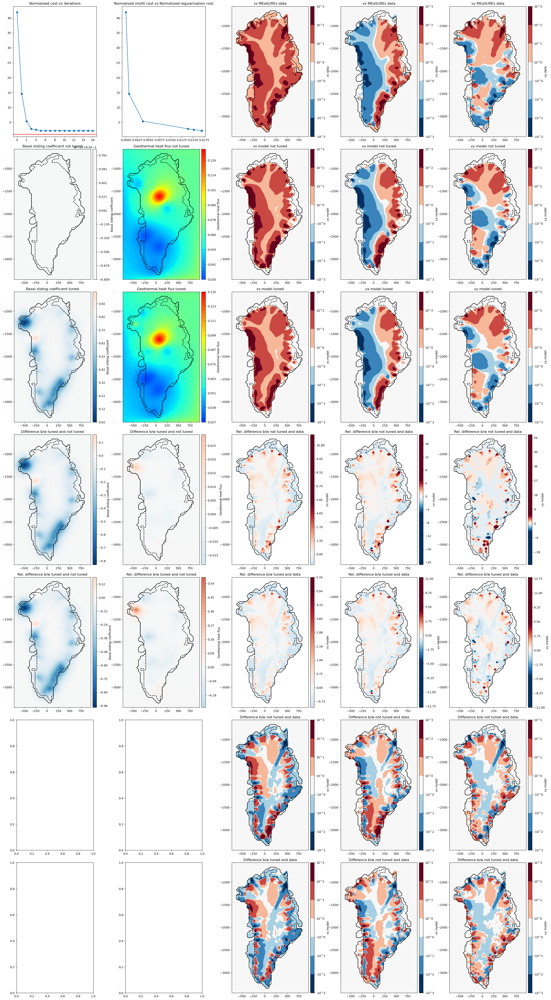

In [9]:
try:
    plotting("3point5", "_pickup", 13, True, 3)
except:
    pass

In [10]:
# try:
#     plotting("3point5", "_modelnotscaled", 2)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5583425871960318 0.674079412923715 1.1253283726147474
0.9598247387579494 0.9631406976911052 1.0434863989938317
0.33967258837918324 0.5358876702570766 1.282243573290999
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
3.616095722815765 11.677869595736505 45.14920162600513
1.5471692885991293 2.8410482976369873 10.359879058887143
0.9875224397190829 5.557928448434737 45.14920162600513
SCALARS
0.018466063680056877 -0.020797915159103342 -0.02179631670239568 -0.0014322879415655798 0.032634838321538906


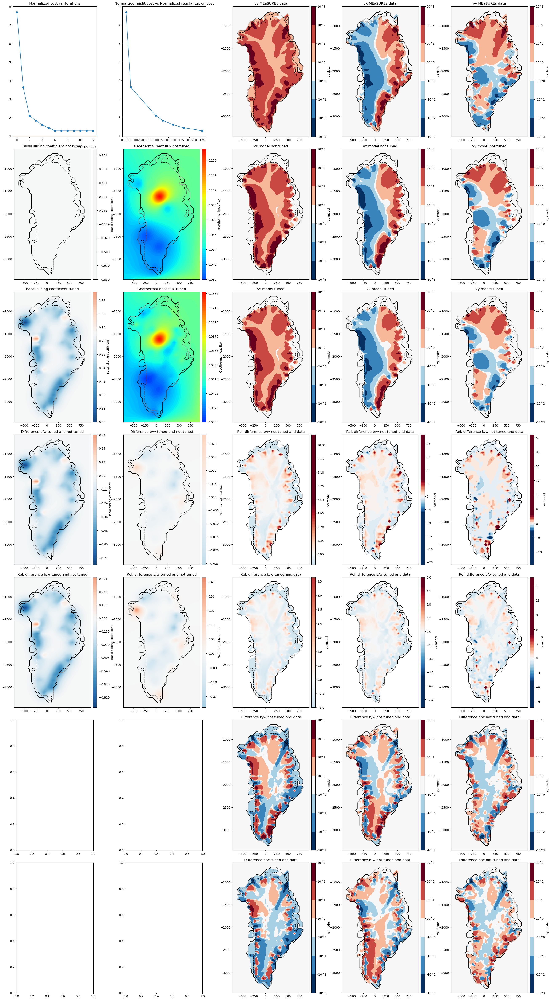

In [11]:
try:
    plotting("3point5", "_modelnotscaled_pickup", 10, True, 2)
except:
    pass

In [12]:
# try:
#     plotting("3point5", "_50", 2)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5615466987870313 0.6286552815617539 0.9582351603150069
0.9691530339834771 0.9725220249027964 1.0103432968673995
0.4490667564651621 0.5573559916645924 1.0342078963207182
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
2.029519744730514 7.6973474649617915 30.377224740791817
1.1841078138341303 2.2764265141879036 5.883309396310701
0.9946040225323058 3.767756291259053 30.377224740791817
SCALARS
0.02699746408262338 -0.022700508891634885 -0.04997498325045069 -0.002987555555435506 0.07811003548774442


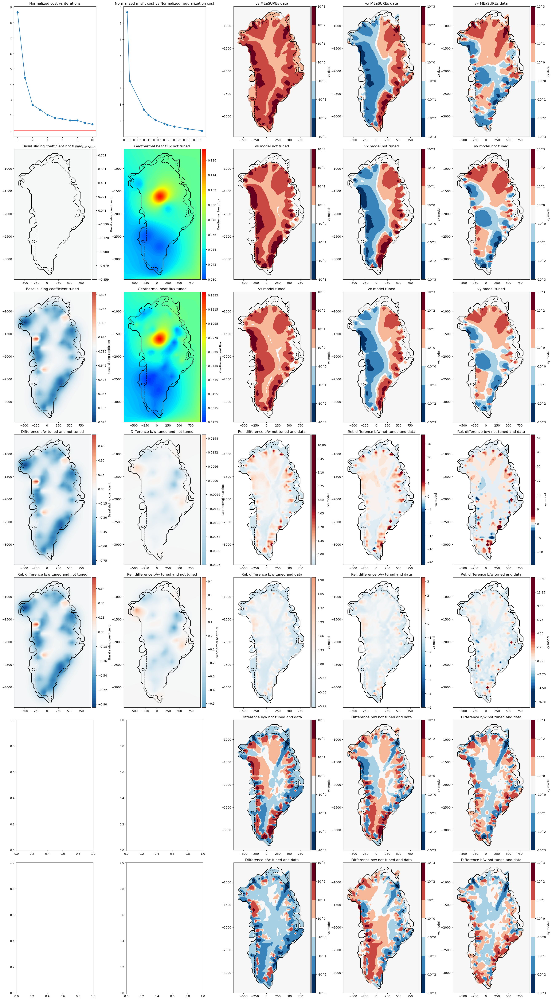

In [13]:
try:
    plotting("3point5", "_50_pickup", 8, True, 2)
except:
    pass

In [14]:
# try:
#     plotting("3point5", "_50_new", 1)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5697675191600019 0.6303540335379442 0.9286396086100848
0.9722228308494453 0.9727467401971261 1.003495928835784
0.47223359632918954 0.5711102068608552 1.0108835895262518
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
1.8265030321097457 7.255691507718857 28.640700895772955
1.0 1.8327430690190134 5.273230876917996
0.9951113123722095 3.5777735022877204 28.640700895772955
SCALARS
0.02787923582842544 -0.03832738055642193 -0.1372029477791128 -0.00773665622313513 0.1713745698149709


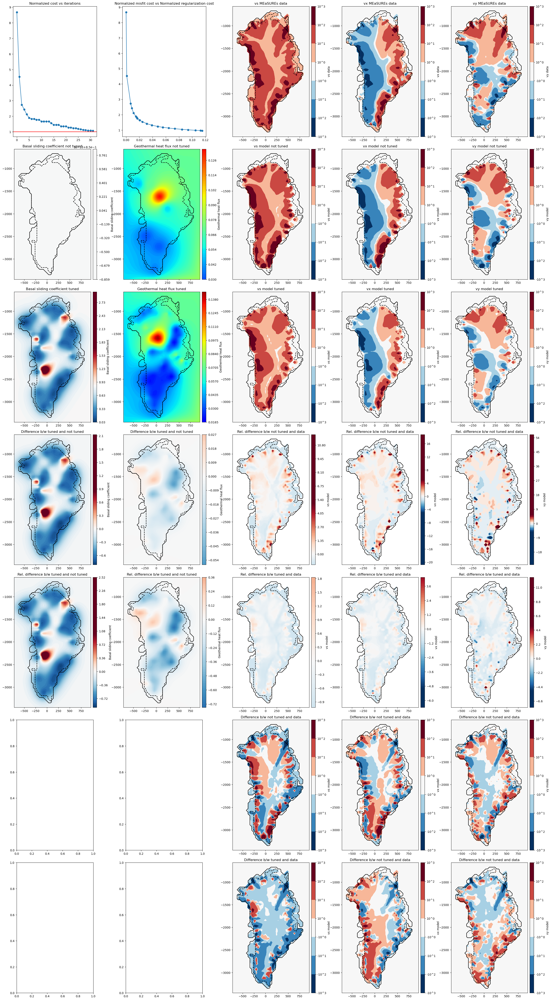

In [20]:
try:
    plotting("3point5", "_50_new_pickup", 29, True, 2)
except:
    pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5721778940461082 0.6269709434273274 0.9012294664398512
0.97003440476496 0.970721772115496 1.0009217666504893
0.48088766456080206 0.5715945138767867 0.9717900441306202
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
1.6070608298038045 6.911031571428046 27.215270202399065
1.0 1.4103878019688767 4.828622081830163
0.9955965182716598 3.3765878149290236 27.215270202399065
SCALARS
0.024792333550121448 -0.04254627140110545 -0.1620162576977845 -0.008876114109787725 0.18644939387603254


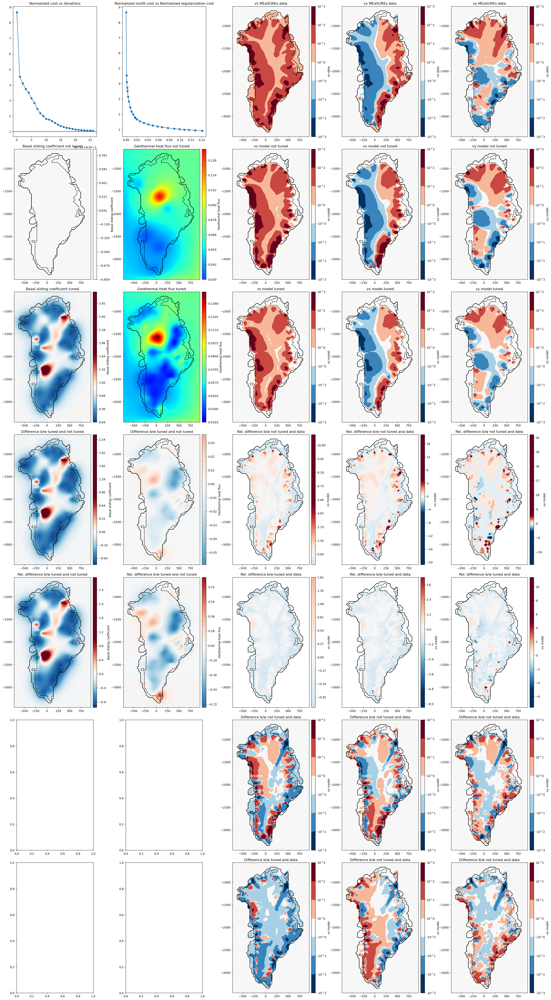

In [19]:
try:
    plotting("3point5", "_50_new_pickup_2", 25, True, 1, 9)
except:
    pass

In [17]:
try:
    plotting("3point5", "_50_new_pickup_3", 1, True, 1, 9)
except:
    pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5765300769465102 0.6266036841084972 0.8735920752223733
0.9716170120392127 0.9715047258659607 0.9966036001722391
0.48957578076770125 0.5746292116780406 0.9487303764587479
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
1.5034214729114241 6.624533238176309 26.056818218556167
1.0 1.2998165242743993 4.751792585208269
0.9960643503634667 3.2385175975041105 26.056818218556167
SCALARS
0.022173344635682435 -0.045561221687615894 -0.1796902372230612 -0.009835510074369114 0.2022933199992354


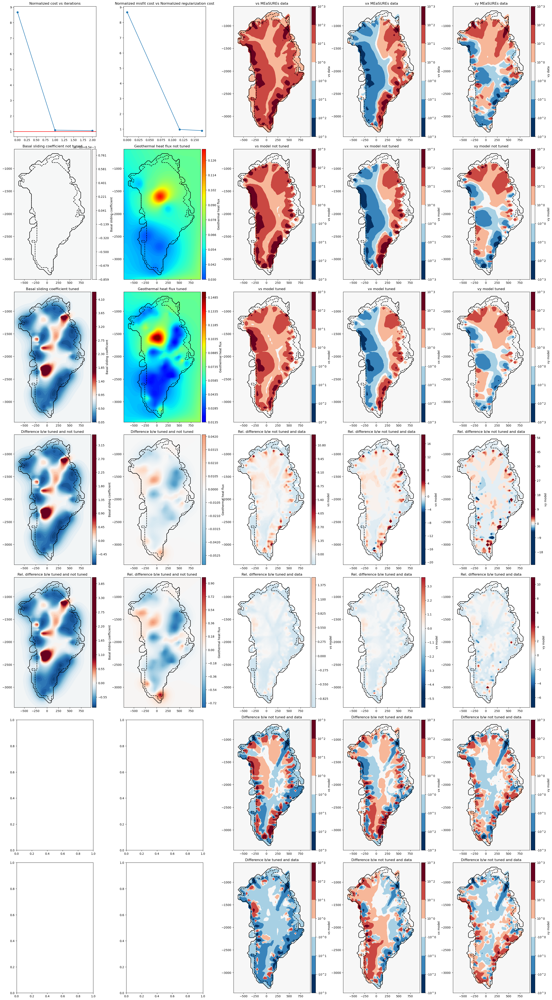

In [18]:
try:
    plotting("3point5", "_50_new_pickup_4", 1, True, 1, 9)
except:
    pass

In [ ]:
# try:
#     plotting("3point5", "_75_new", 1)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5626798068340865 0.6897344984024245 1.2210153537969186
0.9558428508890136 0.9639810795491659 1.122295891606024
0.3277132497352167 0.5312901437206977 1.300882495709393
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
4.083850834427532 11.980394322024503 47.37655613203564
2.134400350839538 3.7372329971205795 23.441390627189598
0.9861338500750136 5.6744290395955765 45.20969176098988
SCALARS
0.01917869865378674 -0.014951767846867692 -0.032290220359109445 -0.0017821045474868402 0.051088350421322426


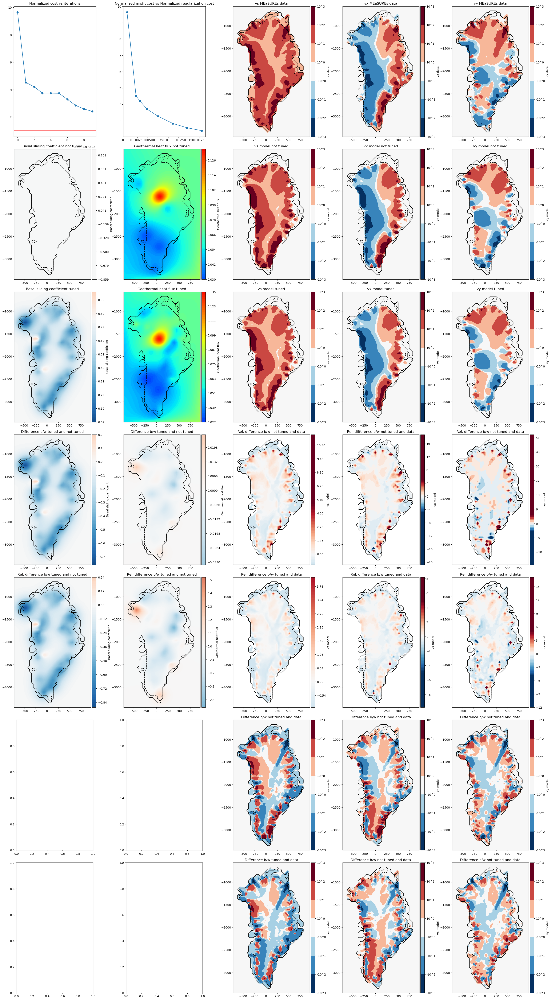

In [94]:
try:
    plotting("3point5", "_75_new_pickup", 8, True, 1)
except:
    pass

In [13]:
# try:
#     plotting("3point5", "_80", 2)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5510979165570554 0.6260507281825315 0.986824590308845
0.9666570856068468 0.9681852234798967 1.0166052882421945
0.38844485775219345 0.5118897498545258 1.1098262006772162
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
2.3136266718566674 7.743824595656766 35.76401206153342
1.2624738063970806 2.106034826618522 6.289651381794766
0.9918469448693624 4.029970941539334 35.76401206153342
SCALARS
0.026797071674351747 -0.03478735839204106 -0.11405664443269892 -0.006144666974618018 0.13605479853197155


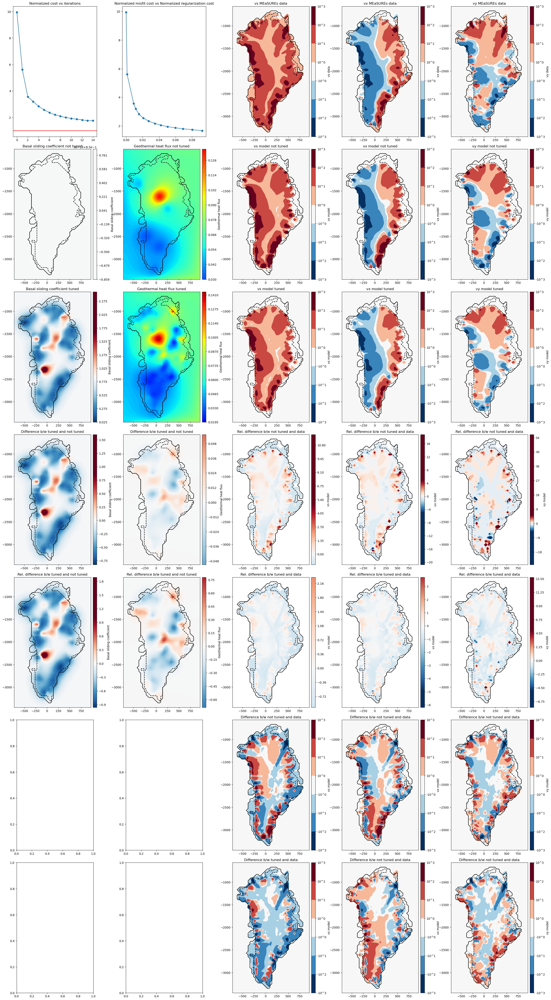

In [14]:
try:
    plotting("3point5", "_80_pickup", 12, True, 2)
except:
    pass

In [ ]:
# try:
#     plotting("3point5", "_80_new", 2)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5524653904576704 0.6509330128417852 1.0881671671830535
0.9640684684398633 0.9655885470487325 1.0369305238044488
0.36776262704373636 0.5243437932244629 1.207123760043811
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
3.424160626577387 9.767313389998542 42.61359821228142
1.761370338087385 3.1655391753206237 8.25642112220962
0.9894964561899839 4.792300322678248 40.581724699469056
SCALARS
0.024350005842576072 -0.019608867950985487 -0.06561123252368894 -0.0035461545664239313 0.08993760036989551


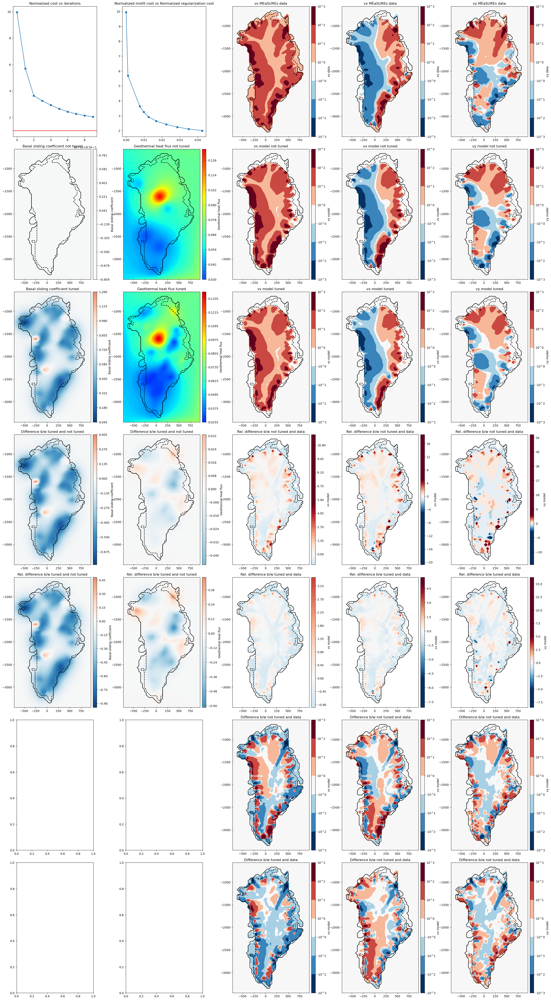

In [93]:
try:
    plotting("3point5", "_80_new_pickup", 7, True, 2)
except:
    pass

In [15]:
# try:
#     plotting("3point5", "_90", 2)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5359682871494319 0.6037209525021497 0.9389019460287067
0.9712602556167756 0.971569564899163 1.0058522897788986
0.2811615813598223 0.4022432138883089 1.0961065937507184
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
1.9660465729346916 7.268276218367897 41.60885785056468
1.0166496027225569 1.8904318267015259 5.6612500787036515
0.9841644045688209 3.5083846571732744 41.60885785056468
SCALARS
0.01220557178052406 -0.04938719392999946 -0.15768768627010032 -0.007730192888973475 0.14193018429739834


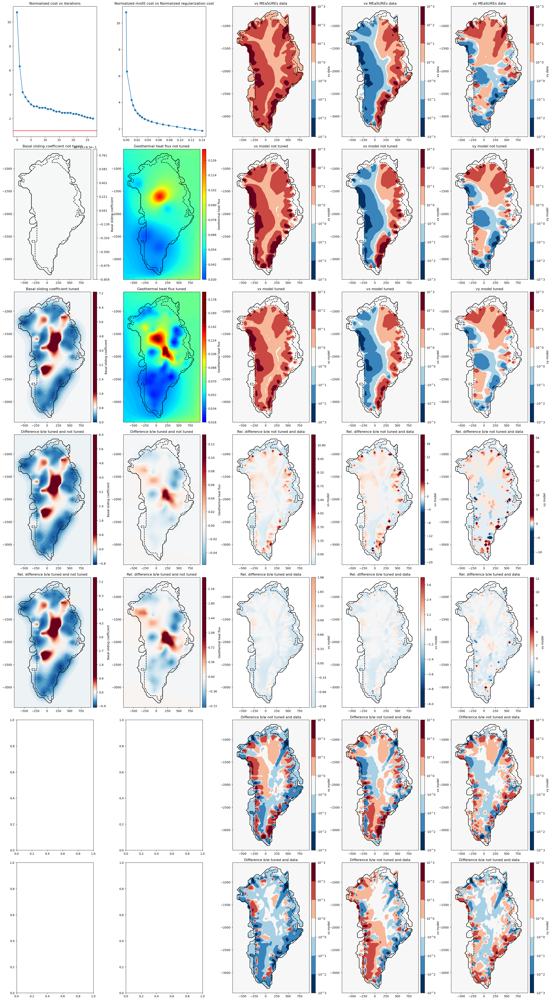

In [16]:
try:
    plotting("3point5", "_90_pickup", 25, True, 2)
except:
    pass

In [17]:
# try:
#     plotting("3point5", "_90_new", 1)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5427297823812369 0.6261170705446575 0.9958634431360842
0.9679752594762369 0.9689520241151005 1.0197550648244453
0.3223271748837 0.4645929794696747 1.1336049244675073
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
2.2045080045464 8.566713452785331 39.1008327122526
1.2851939575647369 2.434467543103055 6.450964648131491
0.9857708492637017 4.1662093129948605 39.1008327122526
SCALARS
0.021035758975775254 -0.03065276092452307 -0.11591460914850582 -0.006109763291810011 0.10677857336949814


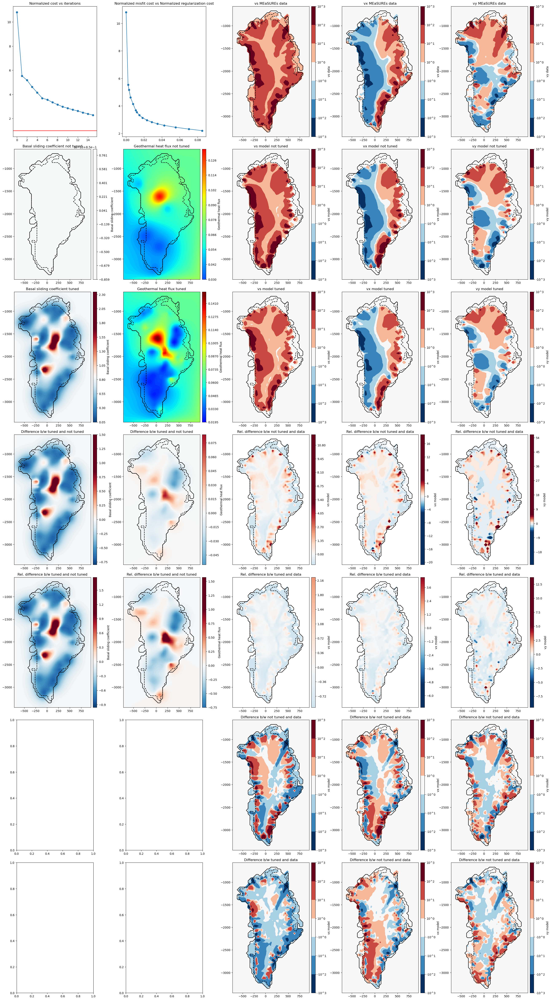

In [92]:
try:
    plotting("3point5", "_90_new_pickup", 14, True, 1)
except:
    pass

In [40]:
# try:
#     plotting("3point5", "_95", 2)
# except:
#     pass

MEAN
0.666579708632735 0.8945715763397264 1.8443565188522428
1.0367045561147665 1.167044143477578 2.361188173309903
0.28332370932918444 0.5662163653690204 1.5104991662637528
0.5282270686138715 0.6015753594187978 0.9679016334440271
0.9633228611338869 0.9645483159620826 1.007254814574999
0.23476280580719774 0.36544319825775046 1.2516657512886502
MAX
11.720779055118513 20.68844243699896 358.72434471052736
11.720779055118513 18.5272951986747 358.72434471052736
0.979677165874167 7.319651667654368 56.87814805354192
1.979944241484958 7.743910370668695 53.03643391276789
1.1073322823621634 2.0369841418963426 5.851329872820396
0.9817069831946562 3.5545448422722905 53.03643391276789
SCALARS
0.014729323218258816 -0.03840996021611032 -0.11278953918366053 -0.006232064223582245 0.10150301969480746


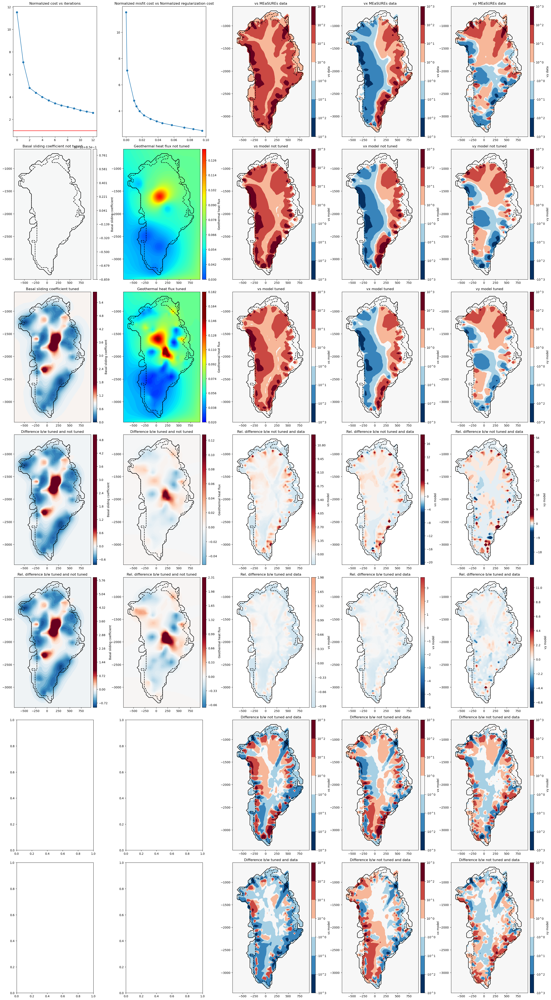

In [41]:
try:
    plotting("3point5", "_95_pickup", 10, True, 2)
except:
    pass

In [42]:
# try:
#     plotting("3point5", "_99", 2)
# except:
#     pass

In [43]:
try:
    plotting("3point5", "_99_pickup", 13, True, 2)
except:
    pass